In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import myutils as u
import math
import datetime
import warnings
import pandas.errors
warnings.simplefilter(action='ignore', category=Warning)

from sklearn.svm import SVR, LinearSVR
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.decomposition import PCA

from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score

# Report

# 1. Introduction

## 1.1 Goal
This report mainly focuses on analyzing the relationship between Bus lateness and Traffic Volume

##  1.2 Datasets

### 1. Winnipeg Transit On Time Performance (OTP)

In [2]:
OTP = u.import_data("ON_TIME_NOV_2021")
OTP

,Stop Number,Route Number,Day Type,Scheduled Time,Deviation,Long,Lat,Route
0,20070,15,Weekday,2021-11-01 00:00:00,46,-97.224042,49.905347,"(15, Sargent-Mountain, Airport via Wellington)"
1,40257,44,Sunday,2021-11-01 00:00:00,-101,-97.072283,49.910398,"(44, Grey, Kildonan Place via Louelda)"
2,10468,15,Sunday,2021-11-01 00:00:22,40,-97.174939,49.897110,"(15, Sargent-Mountain, Airport via Wellington)"
3,40256,44,Sunday,2021-11-01 00:00:30,-96,-97.071036,49.911969,"(44, Grey, Kildonan Place via Louelda)"
4,10466,15,Sunday,2021-11-01 00:00:50,56,-97.177192,49.897181,"(15, Sargent-Mountain, Airport via Wellington)"
...,...,...,...,...,...,...,...,...
4170200,20227,11,Weekday,2021-12-01 00:00:00,109,-97.272134,49.878001,"(11, Portage-Kildonan, Crestview)"
4170201,61208,BLUE,Weekday,2021-12-01 00:00:00,26,-97.158937,49.830545,"(BLUE, Route BLUE, Downtown)"
4170202,10628,15,Weekday,2021-12-01 00:00:00,-26,-97.138599,49.896991,"(15, Sargent-Mountain, Inkster Park via Church)"
4170203,10864,44,Weekday,2021-12-01 00:00:00,-41,-97.145929,49.887043,"(44, Grey, Kildonan Place via London)"


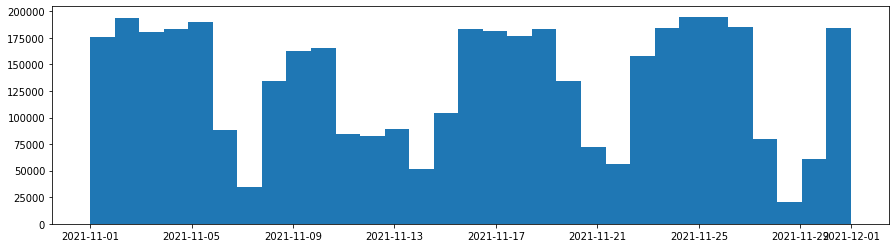

In [4]:
plt.figure(figsize=(15,4))
plt.hist(OTP["Scheduled Time"],bins=31)
plt.show()

### 2. Winnipeg Permanent Count Station Traffic Counts

In [3]:
TC = u.import_data("TRAFFIC_COUNTS_NOV_2021")
TC

,Timestamp,Site,Northbound,Southbound,Eastbound,Westbound,Total,Lat,Long,Street,Near
0,2021-11-01,Marion And 260M E Of Dupuy,NaN,NaN,31.0,9.0,40,49.881900,-97.089342,Marion,Dupuy
1,2021-11-01,McPhillips And 190m South Of Leila,74.0,30.0,NaN,NaN,104,49.951733,-97.149032,McPhillips,Leila
2,2021-11-01,Pembina And 280 N Of Adamar,76.0,92.0,NaN,NaN,168,49.826952,-97.152312,Pembina,Adamar
3,2021-11-01,Lagimodiere And 80M N Of Burmac,40.0,71.0,NaN,NaN,111,49.848695,-97.049665,Lagimodiere,Burmac
4,2021-11-01,Henderson And 55M S Of Frasers Grove,44.0,33.0,NaN,NaN,77,49.934985,-97.096166,Henderson,Grove
...,...,...,...,...,...,...,...,...,...,...,...
22988,2021-12-01,Lagimodiere And 80M N Of Burmac,29.0,68.0,NaN,NaN,97,49.848695,-97.049665,Lagimodiere,Burmac
22989,2021-12-01,Marion And 260M E Of Dupuy,NaN,NaN,26.0,26.0,52,49.881900,-97.089342,Marion,Dupuy
22990,2021-12-01,Disraeli Bridge,88.0,41.0,NaN,NaN,129,49.906744,-97.123028,Disraeli,Bridge
22991,2021-12-01,McPhillips And 190m South Of Leila,62.0,39.0,NaN,NaN,101,49.951733,-97.149032,McPhillips,Leila


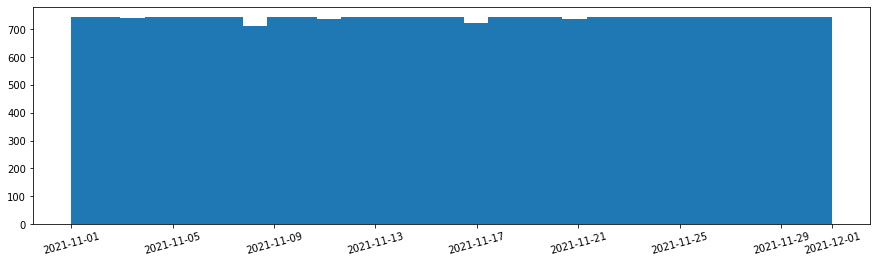

In [6]:
plt.figure(figsize=(15,4))
plt.hist(TC["Timestamp"],bins=31)
plt.xticks(rotation=15)
plt.show()

### 3. Map

In [5]:
import folium
from branca.element import Figure

WINNIPEG = [49.88366050119829, -97.14581222292078]
SITES = u.import_data("SITES")
STOPS = u.import_data("STOPS")
LANE_CLOSURE = u.import_data("LANE_CLOSURE")

In [12]:
fig=Figure(height=1000,width=1000)
m=folium.Map(location=WINNIPEG,tiles='cartodbpositron',zoom_start=12, min_zoom=12)
fig.add_child(m)

# Plotting Traffic count sites
f1=folium.FeatureGroup("Traffic Count Sites")
for i in SITES.index:
    site = SITES.loc[i]
    folium.Marker(location=list(site[["Lat","Long"]]),tooltip=f'{site["Street"]}',popup=f"{site['Site']}",icon=folium.Icon(color="red")).add_to(f1)
    folium.Circle(radius=2000, location=list(site[["Lat","Long"]]),color="orange",fill=True).add_to(f1)
f1.add_to(m)

DF = pd.read_csv("data/traffic_10b.csv").drop(columns=["Unnamed: 0"]).drop_duplicates()
stop_nos = pd.unique(DF["Stop Number"])
stops = STOPS.set_index("Stop Number").loc[stop_nos].reset_index()
stops_1 = stops.set_index("Street").loc[SITES["Street"]].reset_index()
stops_2 = STOPS.set_index("Stop Number").drop(stop_nos).reset_index()

# Plotting Bus stops
f2=folium.FeatureGroup("Bus stops")
for j in stops.index:
    stop = stops.loc[j]
    folium.Circle(radius=4, location=list(stop[["Lat","Long"]]),tooltip=f'{stop["Stop Number"]}',popup=f"{stop['Stop Name']}",color="orange",fill=True).add_to(f2)
for j in stops_1.index:
    stop = stops_1.loc[j]
    folium.Circle(radius=4, location=list(stop[["Lat","Long"]]),tooltip=f'{stop["Stop Number"]}',popup=f"{stop['Stop Name']}",color="red",fill=True).add_to(f2)
for j in stops_2.index:
    stop = stops_2.loc[j]
    folium.Circle(radius=4, location=list(stop[["Lat","Long"]]),tooltip=f'{stop["Stop Number"]}',popup=f"{stop['Stop Name']}",color="#3ea6d6",fill=True).add_to(f2)
f2.add_to(m)

folium.LayerControl().add_to(m)
m

## 2. Evaluations and Results

### 2.2 Evaluation

#### Dataset 1 - August 2021

- Time Period: August (2021-08-01 to 2021-08-31)
- Time Interval: 1h
- Distance of Interest: 2 km 

In [8]:
DF1 = pd.read_csv("data/evaluations/traffic_aug_1h.csv").drop(columns=["Unnamed: 0"]).drop_duplicates()
DF1.loc[:,"Timestamp"] = pd.to_datetime(DF1["Timestamp"])
DF1

,Stop Number,Street,Site,Distance,Same Street,Directional,Total,Arrivals,Average OTP,Timestamp,Time of Day,Day of Week,Day of Year,Time value,Number of Lanes
0,30199,Leila,McPhillips,421.070384,0,0.0,245.0,1.0,-326.0,2021-08-01 01:00:00,1.0,6,213,1627779600000000000,2.0
1,30205,Leila,McPhillips,1689.003285,0,0.0,245.0,1.0,-411.0,2021-08-01 01:00:00,1.0,6,213,1627779600000000000,2.0
2,30206,McGregor,McPhillips,1741.524735,0,0.0,245.0,1.0,-408.0,2021-08-01 01:00:00,1.0,6,213,1627779600000000000,2.0
3,30207,Partridge,McPhillips,1691.791193,0,0.0,245.0,1.0,-28.0,2021-08-01 01:00:00,1.0,6,213,1627779600000000000,2.0
4,30209,McGregor,McPhillips,1718.386291,0,0.0,245.0,1.0,-188.0,2021-08-01 01:00:00,1.0,6,213,1627779600000000000,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
462023,50240,Des Meurons,Marion,1660.747998,0,0.0,426.0,1.0,-158.0,2021-08-31 23:00:00,23.0,1,243,1630450800000000000,4.0
462024,50242,Des Meurons,Marion,1768.441595,0,0.0,426.0,1.0,-145.0,2021-08-31 23:00:00,23.0,1,243,1630450800000000000,4.0
462025,50244,Des Meurons,Marion,1839.032682,0,0.0,426.0,1.0,-161.0,2021-08-31 23:00:00,23.0,1,243,1630450800000000000,4.0
462026,50245,Des Meurons,Marion,1964.515949,0,0.0,426.0,1.0,-152.0,2021-08-31 23:00:00,23.0,1,243,1630450800000000000,4.0


#### Dataset 2 - November 2021

- Time Period: August (2021-11-01 to 2021-11-30)
- Time Interval: 1h
- Distance of Interest: 2 km 

In [9]:
DF2 = pd.read_csv("data/evaluations/traffic_nov_1h.csv").drop(columns=["Unnamed: 0"]).drop_duplicates()
DF2.loc[:,"Timestamp"] = pd.to_datetime(DF2["Timestamp"])
DF2

,Stop Number,Street,Site,Distance,Same Street,Directional,Total,Arrivals,Average OTP,Timestamp,Time of Day,Day of Week,Day of Year,Time value,Number of Lanes
0,30001,McPhillips,McPhillips,1991.190701,1,204.0,619.0,1.0,70.000000,2021-11-01 06:00:00,6.0,0,305,1635746400000000000,3.0
1,30199,Leila,McPhillips,421.070384,0,0.0,619.0,2.0,-0.500000,2021-11-01 06:00:00,6.0,0,305,1635746400000000000,2.0
2,30207,Partridge,McPhillips,1691.791193,0,0.0,619.0,1.0,35.000000,2021-11-01 06:00:00,6.0,0,305,1635746400000000000,2.0
3,30209,McGregor,McPhillips,1718.386291,0,0.0,619.0,1.0,-9.000000,2021-11-01 06:00:00,6.0,0,305,1635746400000000000,2.0
4,30211,McGregor,McPhillips,1727.524447,0,0.0,619.0,1.0,-16.000000,2021-11-01 06:00:00,6.0,0,305,1635746400000000000,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
472683,50260,Marion,Marion,880.704855,1,158.0,353.0,3.0,-110.666667,2021-12-01 00:00:00,0.0,2,335,1638316800000000000,4.0
472684,50261,Marion,Marion,950.386016,1,195.0,353.0,3.0,-103.666667,2021-12-01 00:00:00,0.0,2,335,1638316800000000000,4.0
472685,50295,Lagimodiere,Marion,1329.174369,0,0.0,353.0,1.0,-90.000000,2021-12-01 00:00:00,0.0,2,335,1638316800000000000,2.0
472686,50621,Marion,Marion,745.765722,1,195.0,353.0,3.0,-115.333333,2021-12-01 00:00:00,0.0,2,335,1638316800000000000,4.0


#### Dataset 3 - November 2021

- Time Period: August and November 2021 Combined
- Time Interval: 1h
- Distance of Interest: 2 km 

In [89]:
DF0 = pd.read_csv("data/evaluations/traffic_1h.csv").drop(columns=["Unnamed: 0"]).drop_duplicates()
DF0.loc[:,"Timestamp"] = pd.to_datetime(DF0["Timestamp"])
DF0

,Stop Number,Street,Site,Distance,Same Street,Directional,Total,Arrivals,Average OTP,Timestamp,Time of Day,Day of Week,Day of Year,Time value,Number of Lanes
0,30199,Leila,McPhillips,421.070384,0,0.0,245.0,1.0,-326.000000,2021-08-01 01:00:00,1.0,6,213,1627779600000000000,2.0
1,30205,Leila,McPhillips,1689.003285,0,0.0,245.0,1.0,-411.000000,2021-08-01 01:00:00,1.0,6,213,1627779600000000000,2.0
2,30206,McGregor,McPhillips,1741.524735,0,0.0,245.0,1.0,-408.000000,2021-08-01 01:00:00,1.0,6,213,1627779600000000000,2.0
3,30207,Partridge,McPhillips,1691.791193,0,0.0,245.0,1.0,-28.000000,2021-08-01 01:00:00,1.0,6,213,1627779600000000000,2.0
4,30209,McGregor,McPhillips,1718.386291,0,0.0,245.0,1.0,-188.000000,2021-08-01 01:00:00,1.0,6,213,1627779600000000000,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
472683,50260,Marion,Marion,880.704855,1,158.0,353.0,3.0,-110.666667,2021-12-01 00:00:00,0.0,2,335,1638316800000000000,4.0
472684,50261,Marion,Marion,950.386016,1,195.0,353.0,3.0,-103.666667,2021-12-01 00:00:00,0.0,2,335,1638316800000000000,4.0
472685,50295,Lagimodiere,Marion,1329.174369,0,0.0,353.0,1.0,-90.000000,2021-12-01 00:00:00,0.0,2,335,1638316800000000000,2.0
472686,50621,Marion,Marion,745.765722,1,195.0,353.0,3.0,-115.333333,2021-12-01 00:00:00,0.0,2,335,1638316800000000000,4.0


### Test 1 - Model Performance and Dataset suitability

In [90]:
cols = ["Street","Site","Timestamp","Average OTP"]
X0 = DF0.drop(columns = cols)
X1 = DF1.drop(columns = cols)
X2 = DF2.drop(columns = cols)

y0 = DF0.loc[:,"Average OTP"]
y1 = DF1.loc[:,"Average OTP"]
y2 = DF2.loc[:,"Average OTP"]

scr = []
for X,y in [(X1,y1),(X2,y2),(X0,y0)]:
    scores = {}
    for random_state in range(5):
        evaluators = [
            (LinearSVR, {}),(KNeighborsRegressor, {"n_neighbors":5}),
            (DecisionTreeRegressor, {"random_state":random_state}),
            (RandomForestRegressor, {"random_state":random_state}),
        ]
        for model_, params_ in evaluators:
            model = model_(**params_)
            X_train, X_test, y_train, y_test = train_test_split(X,y,random_state=random_state)
            model.fit(X_train,y_train)
            y_pred = model.predict(X_test)
            r2 = r2_score(y_test,y_pred)

            model_name = type(model).__name__
            if model_name not in scores.keys():
                scores[model_name] = []
            scores[model_name].append(r2)
    scr.append(scores)


df1 = pd.DataFrame(scr[0]).mean().to_frame()
df2 = pd.DataFrame(scr[1]).mean().to_frame()
df3 = pd.DataFrame(scr[2]).mean().to_frame()
df1["type"] = "August 2021"
df2["type"] = "Nov 2021"
df3["type"] = "Both Months"
score_df = pd.concat([df1,df2,df3]).reset_index()
score_df.to_csv("tests/24/test1.csv")
score_df

,index,0,type
0,LinearSVR,-0.253967,August 2021
1,KNeighborsRegressor,0.219058,August 2021
2,DecisionTreeRegressor,0.264441,August 2021
3,RandomForestRegressor,0.574442,August 2021
4,LinearSVR,-0.165791,Nov 2021
5,KNeighborsRegressor,0.544445,Nov 2021
6,DecisionTreeRegressor,0.582471,Nov 2021
7,RandomForestRegressor,0.759289,Nov 2021
8,LinearSVR,-0.157980,Both Months
9,KNeighborsRegressor,0.504456,Both Months


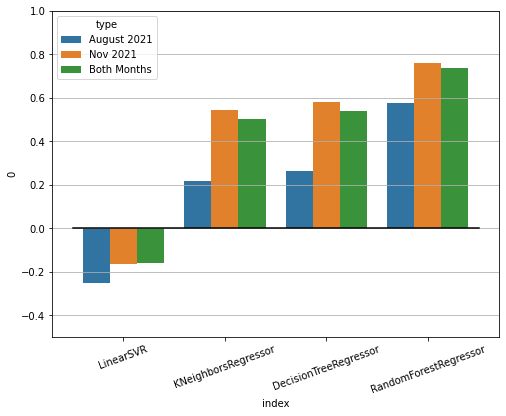

In [91]:
score_df = pd.read_csv("tests/24/test1.csv").drop(columns="Unnamed: 0")
plt.figure(figsize=(8,6))

sns.barplot(x=score_df["index"],y=score_df["0"],hue=score_df["type"])
plt.plot([-0.5,3.5],[0,0],'k')
plt.ylim([-0.5,1])
plt.grid(axis="y")
plt.xticks(rotation=20)
plt.show()

#### Test 2: Time and Location (Stop Number)

Testing the importance of:

- Temporal features
- Stop Number

In [ ]:
# Estimators
evaluators = [
    (LinearSVR, {}),
    (KNeighborsRegressor, {"n_neighbors":5}),
    (DecisionTreeRegressor, {"random_state":random_state}),
    (RandomForestRegressor, {"random_state":random_state}),
]

# Evaluation loop
for model_, params_ in evaluators:
    model = model_(**params_)
    X_train, X_test, y_train, y_test = train_test_split(X,y,random_state=random_state)
    model.fit(X_train,y_train)
    y_pred = model.predict(X_test)
    r2 = r2_score(y_test,y_pred)
    scores.append(r2)

In [24]:
scr = []
X0 = DF.drop(columns = ["Street","Site","Timestamp","Average OTP"]) # All features
X1 = DF.drop(columns = ["Stop Number","Street","Site","Timestamp","Average OTP"]) # No Stop Number
X2 = DF.drop(columns = ["Street","Site","Timestamp","Average OTP","Time of Day","Day of Week","Day of Year","Time value"]) # No Time data
y  = DF.loc[:,"Average OTP"]

for X in [X0,X1,X2]:
    scores = {}
    for random_state in range(5):
        evaluators = [
            (LinearSVR, {}),(KNeighborsRegressor, {"n_neighbors":5}),
            (DecisionTreeRegressor, {"random_state":random_state}),
            (RandomForestRegressor, {"random_state":random_state}),
        ]
        for model_, params_ in evaluators:
            model = model_(**params_)
            X_train, X_test, y_train, y_test = train_test_split(X,y,random_state=random_state)
            model.fit(X_train,y_train)
            y_pred = model.predict(X_test)
            r2 = r2_score(y_test,y_pred)

            model_name = type(model).__name__
            if model_name not in scores.keys():
                scores[model_name] = []
            scores[model_name].append(r2)
    scr.append(scores)
    
df1 = pd.DataFrame(scr[0]).mean().to_frame()
df2 = pd.DataFrame(scr[1]).mean().to_frame()
df3 = pd.DataFrame(scr[2]).mean().to_frame()
df1["type"] = "all features"
df2["type"] = "no Stop Number"
df3["type"] = "no Time data"
score_df = pd.concat([df3,df2,df1]).reset_index()
score_df.to_csv("tests/23/test1.csv")
score_df

,index,0,type
0,LinearSVR,-0.625271,no Time data
1,KNeighborsRegressor,-0.006509,no Time data
2,DecisionTreeRegressor,0.469236,no Time data
3,RandomForestRegressor,0.707538,no Time data
4,LinearSVR,-0.181737,no Stop Number
5,KNeighborsRegressor,0.447659,no Stop Number
6,DecisionTreeRegressor,0.346245,no Stop Number
7,RandomForestRegressor,0.596249,no Stop Number
8,LinearSVR,-0.181737,all features
9,KNeighborsRegressor,0.555260,all features


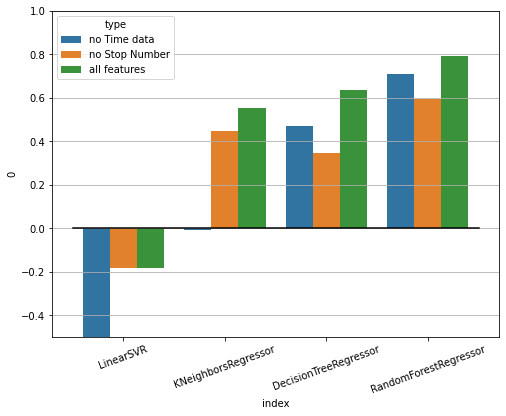

In [26]:
score_df = pd.read_csv("tests/23/test1.csv").drop(columns="Unnamed: 0")
plt.figure(figsize=(8,6))

sns.barplot(x=score_df["index"],y=score_df["0"],hue=score_df["type"])
plt.plot([-0.5,3.5],[0,0],'k')
plt.ylim([-0.5,1])
plt.grid(axis="y")
plt.xticks(rotation=20)
plt.show()

**Remark**: 

- Information regarding Stop Number plays a role in making the regression better, suggesting that the Bus OTP situation is linked to the bus stop itself
- Temporal features are critical for regression. It is the difference maker between a poor and a decent model (in the case of KNR and Decision TreeRegressor) and a decent and good model in the case of RandomForestRegressor

#### Test 3: Same Street vs Different Street

Testing the difference between:

- Same Street bus stops (to count station), and
- Different Street bus stops

In [27]:
X0 = DF[DF["Same Street"]==0].drop(columns = ["Street","Site","Timestamp","Average OTP"]) # Different Street
X1 = DF[DF["Same Street"]==1].drop(columns = ["Street","Site","Timestamp","Average OTP"]) # Same Street
X0

,Stop Number,Distance,Same Street,Directional,Total,Arrivals,Time of Day,Day of Week,Day of Year,Time value
0,30199,421.070384,0,0.0,418.0,2.0,2.0,6,213,1627783200000000000
1,30205,1689.003285,0,0.0,418.0,2.0,2.0,6,213,1627783200000000000
2,30206,1741.524735,0,0.0,418.0,2.0,2.0,6,213,1627783200000000000
3,30207,1691.791193,0,0.0,418.0,1.0,2.0,6,213,1627783200000000000
4,30209,1718.386291,0,0.0,418.0,1.0,2.0,6,213,1627783200000000000
...,...,...,...,...,...,...,...,...,...,...
323691,50141,662.005989,0,0.0,735.0,5.0,0.0,2,335,1638316800000000000
323692,50248,1532.838155,0,0.0,735.0,5.0,0.0,2,335,1638316800000000000
323693,50249,1775.547757,0,0.0,735.0,5.0,0.0,2,335,1638316800000000000
323699,50295,1329.174369,0,0.0,735.0,3.0,0.0,2,335,1638316800000000000


In [ ]:
scr = []
X0 = DF[DF["Same Street"]==0].drop(columns = ["Street","Site","Timestamp","Average OTP"]) # Different Street
X1 = DF[DF["Same Street"]==1].drop(columns = ["Street","Site","Timestamp","Average OTP"]) # Same Street
y0 = DF.loc[(DF["Same Street"]==0),"Average OTP"]
y1 = DF.loc[(DF["Same Street"]==1),"Average OTP"]

for X,y in [(X0,y0),(X1,y1)]:
    scores = {}
    for random_state in range(5):
        evaluators = [
            (LinearSVR, {}),(KNeighborsRegressor, {"n_neighbors":5}),
            (DecisionTreeRegressor, {"random_state":random_state}),
            (RandomForestRegressor, {"random_state":random_state}),
        ]
        for model_, params_ in evaluators:
            model = model_(**params_)
            X_train, X_test, y_train, y_test = train_test_split(X,y,random_state=random_state)
            model.fit(X_train,y_train)
            y_pred = model.predict(X_test)
            r2 = r2_score(y_test,y_pred)

            model_name = type(model).__name__
            if model_name not in scores.keys():
                scores[model_name] = []
            scores[model_name].append(r2)
    scr.append(pd.DataFrame(scores))


In [39]:
df1 = pd.DataFrame(scr[0]).mean().to_frame()
df2 = pd.DataFrame(scr[1]).mean().to_frame()
df1["type"] = "Different Street"
df2["type"] = "Same Street"
score_df = pd.concat([df1,df2]).reset_index()
score_df.to_csv("tests/23/test2.csv")
score_df

,index,0,type
0,LinearSVR,-0.174836,Different Street
1,KNeighborsRegressor,0.535376,Different Street
2,DecisionTreeRegressor,0.619065,Different Street
3,RandomForestRegressor,0.778154,Different Street
4,LinearSVR,-0.218495,Same Street
5,KNeighborsRegressor,0.710653,Same Street
6,DecisionTreeRegressor,0.849792,Same Street
7,RandomForestRegressor,0.904083,Same Street


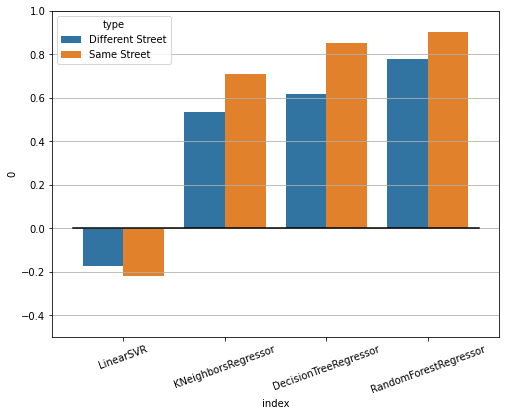

In [40]:
score_df = pd.read_csv("tests/23/test2.csv").drop(columns="Unnamed: 0")
plt.figure(figsize=(8,6))

sns.barplot(x=score_df["index"],y=score_df["0"],hue=score_df["type"])
plt.plot([-0.5,3.5],[0,0],'k')
plt.ylim([-0.5,1])
plt.grid(axis="y")
plt.xticks(rotation=20)
plt.show()

#### Test 3: Construction Data

- Number of Nearby Constructions
- Existence of Same Street Construction
- Number of Lanes on the street 

In [11]:
fig=Figure(height=1000,width=1000)
m=folium.Map(location=WINNIPEG,tiles='cartodbpositron',zoom_start=12, min_zoom=12)
fig.add_child(m)

# Plotting Bus stops
f2=folium.FeatureGroup("Bus stops")
for j in STOPS.index:
    stop = STOPS.loc[j]
    folium.Circle(radius=4, location=list(stop[["Lat","Long"]]),tooltip=f'{stop["Stop Number"]}',popup=f"{stop['Stop Name']}",color="#3ea6d6",fill=True).add_to(f2)
f2.add_to(m)

color = {"Yes":"red","No":"orange"}
f3=folium.FeatureGroup("Road closure")
for j in LANE_CLOSURE.index:
    lane = LANE_CLOSURE.iloc[j]
    for i in range(len(lane["Geometry"])):
        line_1=folium.vector_layers.PolyLine(lane["Geometry"][i],popup=f'<b>Direction:</b> {", ".join(lane["Direction"])}',tooltip=f'{lane["Street"]}',color=color[lane["Complete Closure"]],weight=4).add_to(f3)
f3.add_to(m)
folium.LayerControl().add_to(m)
m

In [13]:
DF3 = pd.read_csv("data/evaluations/traffic_nov_1h_constr.csv").drop(columns=["Unnamed: 0"]).drop_duplicates()
DF3.loc[:,"Timestamp"] = pd.to_datetime(DF3["Timestamp"])
DF3

,Stop Number,Street,Site,Distance,Same Street,Directional,Total,Arrivals,Average OTP,Timestamp,Time of Day,Day of Week,Day of Year,Time value,Number of Lanes,Nearby Constr,Same Street Constr
0,30001,McPhillips,McPhillips,1991.190701,1,204.0,619.0,1.0,70.000000,2021-11-01 06:00:00,6.0,0,305,1635746400000000000,3.0,0.0,0.0
1,30199,Leila,McPhillips,421.070384,0,0.0,619.0,2.0,-0.500000,2021-11-01 06:00:00,6.0,0,305,1635746400000000000,2.0,0.0,0.0
2,30207,Partridge,McPhillips,1691.791193,0,0.0,619.0,1.0,35.000000,2021-11-01 06:00:00,6.0,0,305,1635746400000000000,2.0,2.0,0.0
3,30209,McGregor,McPhillips,1718.386291,0,0.0,619.0,1.0,-9.000000,2021-11-01 06:00:00,6.0,0,305,1635746400000000000,2.0,2.0,0.0
4,30211,McGregor,McPhillips,1727.524447,0,0.0,619.0,1.0,-16.000000,2021-11-01 06:00:00,6.0,0,305,1635746400000000000,4.0,2.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
472683,50260,Marion,Marion,880.704855,1,158.0,353.0,3.0,-110.666667,2021-12-01 00:00:00,0.0,2,335,1638316800000000000,4.0,4.0,0.0
472684,50261,Marion,Marion,950.386016,1,195.0,353.0,3.0,-103.666667,2021-12-01 00:00:00,0.0,2,335,1638316800000000000,4.0,4.0,0.0
472685,50295,Lagimodiere,Marion,1329.174369,0,0.0,353.0,1.0,-90.000000,2021-12-01 00:00:00,0.0,2,335,1638316800000000000,2.0,0.0,0.0
472686,50621,Marion,Marion,745.765722,1,195.0,353.0,3.0,-115.333333,2021-12-01 00:00:00,0.0,2,335,1638316800000000000,4.0,4.0,0.0


In [14]:
scr = []
X3 = DF3.drop(columns = ["Street","Site","Timestamp","Average OTP"]) # With Construction Data
y3 = DF3.loc[:,"Average OTP"]

for X,y in [(X3,y3)]:
    scores = {}
    for random_state in range(3):
        evaluators = [
            (LinearSVR, {}),(KNeighborsRegressor, {"n_neighbors":5}),
            (DecisionTreeRegressor, {"random_state":random_state}),
            (RandomForestRegressor, {"random_state":random_state}),
        ]
        for model_, params_ in evaluators:
            model = model_(**params_)
            X_train, X_test, y_train, y_test = train_test_split(X,y,random_state=random_state)
            model.fit(X_train,y_train)
            y_pred = model.predict(X_test)
            r2 = r2_score(y_test,y_pred)

            model_name = type(model).__name__
            if model_name not in scores.keys():
                scores[model_name] = []
            scores[model_name].append(r2)
    scr.append(pd.DataFrame(scores))
pd.concat(scr).to_csv("tests/24/test4.csv")

In [24]:
score_df = pd.read_csv("tests/24/test1.csv").drop(columns="Unnamed: 0").set_index("index")
scr2 = score_df[score_df['type']=="Nov 2021"]
scr2["type"] = "No Construction data"
scr2

,0,type
index,,
LinearSVR,-0.165791,No Construction data
KNeighborsRegressor,0.544445,No Construction data
DecisionTreeRegressor,0.582471,No Construction data
RandomForestRegressor,0.759289,No Construction data


In [26]:
scr1 = scr[0].mean().to_frame()
scr1["type"] = "With Construction data"
scr1

,0,type
LinearSVR,-0.165791,With Construction data
KNeighborsRegressor,0.544414,With Construction data
DecisionTreeRegressor,0.591031,With Construction data
RandomForestRegressor,0.761905,With Construction data


In [27]:
scr1["0"] = scr1[0]
scr1 = scr1.drop(columns=0)
scr1

,type,0
LinearSVR,With Construction data,-0.165791
KNeighborsRegressor,With Construction data,0.544414
DecisionTreeRegressor,With Construction data,0.591031
RandomForestRegressor,With Construction data,0.761905


In [29]:
pd.concat([scr2,scr1])

,0,type
LinearSVR,-0.165791,No Construction data
KNeighborsRegressor,0.544445,No Construction data
DecisionTreeRegressor,0.582471,No Construction data
RandomForestRegressor,0.759289,No Construction data
LinearSVR,-0.165791,With Construction data
KNeighborsRegressor,0.544414,With Construction data
DecisionTreeRegressor,0.591031,With Construction data
RandomForestRegressor,0.761905,With Construction data


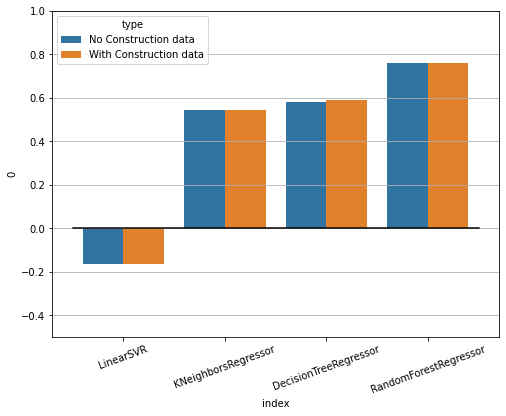

In [31]:
# df1 = pd.DataFrame(scr[0]).mean().to_frame()
# df2 = pd.DataFrame(scr[1]).mean().to_frame()
# df1["type"] = "All features"
# df2["type"] = "No Number of Lanes"
df = pd.concat([scr2,scr1]).reset_index()
plt.figure(figsize=(8,6))
sns.barplot(x=df["index"],y=df["0"],hue=df["type"])
plt.plot([-0.5,3.5],[0,0],'k')
plt.ylim([-0.5,1])
plt.grid(axis="y")
plt.xticks(rotation=20)
plt.show()

#### Test 4: Future Prediction


In [ ]:
random_state = 1
data = DF2
freq="1h"
scores = []

for date in pd.date_range(start = "2021-11-28 12:00:00", end = "2021-11-28 18:00:00",freq=freq):
    data_test = data[(data["Timestamp"] >= date) & (data["Timestamp"] < date + pd.to_timedelta(freq))]
    data_train = data[(data["Timestamp"] < date)]
    if len(data_test) > 0:
        X_train = data_train.drop(columns = ["Street","Site","Timestamp","Average OTP"])
        X_test = data_test.drop(columns = ["Street","Site","Timestamp","Average OTP"])
        y_train = data_train["Average OTP"]
        y_test = data_test["Average OTP"]
        model = RandomForestRegressor(random_state=random_state)
        model.fit(X_train,y_train)
        y_pred = model.predict(X_test)
        r2 = r2_score(y_test,y_pred)
        scores.append(r2)
        print(date,r2)